#### 패키지 불러오기

In [1]:
# 데이터 구성:Series, DataFrame
import pandas as pd
import numpy as np
# 데이터 시각화
import matplotlib.pyplot as plt
import matplotlib
# export_graphviz: 나무 구조 생성 및 저장 
from sklearn.tree import export_graphviz
# graphviz : 나무 구조 시각화  (.dot 확장자 파일 불러오기 등)
import graphviz

# 다른 방식(.dot -> .png 형식, 출력화면에 맞는)으로 Tree 출력
from subprocess import call
from IPython.display import Image

# 데이터 분할:train, test
from sklearn.model_selection import train_test_split
# 분류 Decision Tree
from sklearn.tree import DecisionTreeClassifier
# 최적 모델, 파라미터 탐색
from sklearn.model_selection import GridSearchCV

# 분류모델 평가 함수
from sklearn.metrics import accuracy_score, f1_score 
from sklearn.metrics import confusion_matrix, classification_report

In [2]:
# Tree 생성경로 지정
import os
# PATH 설정: graphviz를 설치 했다면, 설치 된 경로를 설정. 기본 경로는 아래 예제 참고(linux에서 설치된 경로 확인 및 변경 필요)
# os.environ["PATH"] += os.pathsep + "C:/Program Files (x86)/Graphviz2.38/bin/"
os.environ["PATH"] += os.pathsep + "C:/Program Files/Graphviz/bin/"

In [3]:
# 그래프 한글폰트 적용:맑은 고딕
matplotlib.rc("font", family = "Malgun Gothic")
# 그래프 (-) 기호 표시
matplotlib.rc("axes", unicode_minus = False)

In [4]:
# 데이터 불러오기
df_raw = pd.read_csv("/home/piai/바탕화면/빅데이터_이차전지/bat_process.csv")
df_raw.head()

,lot_id,tray_id,dt_start,cell_id,judge,rta1_cell_no,rta1_box_col,rta1_box_row,rta1_box_dan,hta1_box_col,...,ocv1_deltaocv,m1_thick,m1_voltage,m1_res_ac,m1_mv,m1_voltage_an,dt_start_old,sa4_box_row,sa4_box_col,sa4_box_dan
0,LOT-100,TRAY-1023,01SEP2022:10:01:25,CELL-10747,양품,10,08열,33연,08단,03열,...,6.8,4718.0,37583.0,94.0,565.0,164.0,01SEP2020:10:01:25,07열,27연,03단
1,LOT-100,TRAY-1023,01SEP2022:10:01:25,CELL-10748,양품,7,08열,33연,08단,03열,...,6.8,4718.0,37574.0,94.0,565.0,73.0,01SEP2020:10:01:25,07열,27연,03단
2,LOT-100,TRAY-1023,01SEP2022:10:01:25,CELL-10749,양품,19,08열,33연,08단,03열,...,6.9,4700.0,37579.0,91.0,585.0,-57.0,01SEP2020:10:01:25,07열,27연,03단
3,LOT-100,TRAY-1023,01SEP2022:10:01:25,CELL-10750,양품,24,08열,33연,08단,03열,...,6.9,4688.0,37583.0,93.0,606.0,99.0,01SEP2020:10:01:25,07열,27연,03단
4,LOT-100,TRAY-1023,01SEP2022:10:01:25,CELL-10751,양품,17,08열,33연,08단,03열,...,6.8,4696.0,37570.0,91.0,605.0,36.0,01SEP2020:10:01:25,07열,27연,03단


In [5]:
columns_to_keep = ['ocv1_ocv','ocv2_ocv','pg1_imp','pg1_voltage_start','pg1_temp_avg'
                  ,'socv1_ocv','socv2_ocv','socv3_ocv','m1_voltage','m1_res_ac','m1_mv','m1_voltage_an'
                  ,'judge']
df_raw = df_raw[columns_to_keep]

# 결과 확인
print(df_raw)

       ocv1_ocv  ocv2_ocv  pg1_imp  pg1_voltage_start  pg1_temp_avg  \
0          3333      3764     2114               3759           288   
1          3329      3763     2127               3758           288   
2          3329      3764     2120               3759           288   
3          3330      3764     2117               3759           288   
4          3330      3762     2124               3758           288   
...         ...       ...      ...                ...           ...   
44073      3320      3762     2192               3759           275   
44074      3322      3762     2214               3759           275   
44075      3329      3764     2224               3759           275   
44076      3325      3764     2214               3759           275   
44077      3321      3764     2231               3760           275   

       socv1_ocv  socv2_ocv  socv3_ocv  m1_voltage  m1_res_ac  m1_mv  \
0         3766.1     3761.1     3759.3     37583.0       94.0  565.0   
1  

In [6]:
# 결측치 확인
df_raw.isnull().sum(axis = 0)
# 결측치가 있는 행을 제거
df_cleaned = df_raw.dropna()

# 결과 확인
print(df_cleaned)
# 결측치 처리 확인
df_cleaned.isnull().sum()

       ocv1_ocv  ocv2_ocv  pg1_imp  pg1_voltage_start  pg1_temp_avg  \
0          3333      3764     2114               3759           288   
1          3329      3763     2127               3758           288   
2          3329      3764     2120               3759           288   
3          3330      3764     2117               3759           288   
4          3330      3762     2124               3758           288   
...         ...       ...      ...                ...           ...   
44073      3320      3762     2192               3759           275   
44074      3322      3762     2214               3759           275   
44075      3329      3764     2224               3759           275   
44076      3325      3764     2214               3759           275   
44077      3321      3764     2231               3760           275   

       socv1_ocv  socv2_ocv  socv3_ocv  m1_voltage  m1_res_ac  m1_mv  \
0         3766.1     3761.1     3759.3     37583.0       94.0  565.0   
1  

ocv1_ocv             0
ocv2_ocv             0
pg1_imp              0
pg1_voltage_start    0
pg1_temp_avg         0
socv1_ocv            0
socv2_ocv            0
socv3_ocv            0
m1_voltage           0
m1_res_ac            0
m1_mv                0
m1_voltage_an        0
judge                0
dtype: int64

#### 범주형 설명변수 더미 변환

In [7]:
# get_dummies: 데이터의 문자형 변수에 대한 더미변수 생성 
df_raw_dummy = pd.get_dummies(df_cleaned)
df_raw_dummy.head()

,ocv1_ocv,ocv2_ocv,pg1_imp,pg1_voltage_start,pg1_temp_avg,socv1_ocv,socv2_ocv,socv3_ocv,m1_voltage,m1_res_ac,m1_mv,m1_voltage_an,judge_불량,judge_양품
0,3333,3764,2114,3759,288,3766.1,3761.1,3759.3,37583.0,94.0,565.0,164.0,0,1
1,3329,3763,2127,3758,288,3765.2,3760.2,3758.4,37574.0,94.0,565.0,73.0,0,1
2,3329,3764,2120,3759,288,3765.9,3760.8,3759.0,37579.0,91.0,585.0,-57.0,0,1
3,3330,3764,2117,3759,288,3766.4,3761.3,3759.5,37583.0,93.0,606.0,99.0,0,1
4,3330,3762,2124,3758,288,3765.0,3760.0,3758.2,37570.0,91.0,605.0,36.0,0,1


In [8]:
# 'judge_양품' 열을 지우고 나머지 열을 유지
df_raw = df_raw_dummy.drop(columns=['judge_양품'])

df_raw.head()

,ocv1_ocv,ocv2_ocv,pg1_imp,pg1_voltage_start,pg1_temp_avg,socv1_ocv,socv2_ocv,socv3_ocv,m1_voltage,m1_res_ac,m1_mv,m1_voltage_an,judge_불량
0,3333,3764,2114,3759,288,3766.1,3761.1,3759.3,37583.0,94.0,565.0,164.0,0
1,3329,3763,2127,3758,288,3765.2,3760.2,3758.4,37574.0,94.0,565.0,73.0,0
2,3329,3764,2120,3759,288,3765.9,3760.8,3759.0,37579.0,91.0,585.0,-57.0,0
3,3330,3764,2117,3759,288,3766.4,3761.3,3759.5,37583.0,93.0,606.0,99.0,0
4,3330,3762,2124,3758,288,3765.0,3760.0,3758.2,37570.0,91.0,605.0,36.0,0


#### 데이터 분리/ 분할

In [11]:
# 데이터 분리:설명변수, 목표변수 구분
df_raw_x = df_raw.drop("judge_불량", axis = 1, inplace = False)
df_raw_y = df_raw["judge_불량"] 

# 데이터 분할 train_test_split(X: 설명변수, Y: 목표변수, test_size = test 데이터 비율)
df_train_x, df_test_x, df_train_y, df_test_y = train_test_split(
    df_raw_x, df_raw_y, test_size = 0.3, random_state = 1234) 

print("분할 전 설명변수 데이터 :", df_raw_x.shape)
print("분할 후 설명변수 데이터 :Train", df_train_x.shape, "  Test",df_test_x.shape)

분할 전 설명변수 데이터 : (43981, 12)
분할 후 설명변수 데이터 :Train (30786, 12)   Test (13195, 12)


In [12]:
display(df_raw.head(10))
display(df_raw_x.head(10))

,ocv1_ocv,ocv2_ocv,pg1_imp,pg1_voltage_start,pg1_temp_avg,socv1_ocv,socv2_ocv,socv3_ocv,m1_voltage,m1_res_ac,m1_mv,m1_voltage_an,judge_불량
0,3333,3764,2114,3759,288,3766.1,3761.1,3759.3,37583.0,94.0,565.0,164.0,0
1,3329,3763,2127,3758,288,3765.2,3760.2,3758.4,37574.0,94.0,565.0,73.0,0
2,3329,3764,2120,3759,288,3765.9,3760.8,3759.0,37579.0,91.0,585.0,-57.0,0
3,3330,3764,2117,3759,288,3766.4,3761.3,3759.5,37583.0,93.0,606.0,99.0,0
4,3330,3762,2124,3758,288,3765.0,3760.0,3758.2,37570.0,91.0,605.0,36.0,0
5,3329,3763,2118,3758,288,3765.6,3760.5,3758.7,37576.0,91.0,585.0,-40.0,0
6,3327,3763,2134,3758,288,3765.4,3760.4,3758.6,37576.0,94.0,565.0,180.0,0
7,3328,3762,2124,3757,288,3764.9,3759.9,3758.2,37572.0,94.0,545.0,36.0,0
8,3332,3762,2115,3758,288,3765.1,3760.1,3758.3,37572.0,91.0,585.0,-26.0,0
9,3330,3764,2132,3758,288,3765.9,3760.9,3759.1,37581.0,93.0,565.0,157.0,0


,ocv1_ocv,ocv2_ocv,pg1_imp,pg1_voltage_start,pg1_temp_avg,socv1_ocv,socv2_ocv,socv3_ocv,m1_voltage,m1_res_ac,m1_mv,m1_voltage_an
0,3333,3764,2114,3759,288,3766.1,3761.1,3759.3,37583.0,94.0,565.0,164.0
1,3329,3763,2127,3758,288,3765.2,3760.2,3758.4,37574.0,94.0,565.0,73.0
2,3329,3764,2120,3759,288,3765.9,3760.8,3759.0,37579.0,91.0,585.0,-57.0
3,3330,3764,2117,3759,288,3766.4,3761.3,3759.5,37583.0,93.0,606.0,99.0
4,3330,3762,2124,3758,288,3765.0,3760.0,3758.2,37570.0,91.0,605.0,36.0
5,3329,3763,2118,3758,288,3765.6,3760.5,3758.7,37576.0,91.0,585.0,-40.0
6,3327,3763,2134,3758,288,3765.4,3760.4,3758.6,37576.0,94.0,565.0,180.0
7,3328,3762,2124,3757,288,3764.9,3759.9,3758.2,37572.0,94.0,545.0,36.0
8,3332,3762,2115,3758,288,3765.1,3760.1,3758.3,37572.0,91.0,585.0,-26.0
9,3330,3764,2132,3758,288,3765.9,3760.9,3759.1,37581.0,93.0,565.0,157.0


In [13]:
# Data 구조 확인
print("Data 구조:", df_raw_x.columns)
print()
print("변수 : ", df_train_x.columns)

Data 구조: Index(['ocv1_ocv', 'ocv2_ocv', 'pg1_imp', 'pg1_voltage_start', 'pg1_temp_avg',
       'socv1_ocv', 'socv2_ocv', 'socv3_ocv', 'm1_voltage', 'm1_res_ac',
       'm1_mv', 'm1_voltage_an'],
      dtype='object')

변수 :  Index(['ocv1_ocv', 'ocv2_ocv', 'pg1_imp', 'pg1_voltage_start', 'pg1_temp_avg',
       'socv1_ocv', 'socv2_ocv', 'socv3_ocv', 'm1_voltage', 'm1_res_ac',
       'm1_mv', 'm1_voltage_an'],
      dtype='object')


### @불균형 자료 사전 처리:over-, under-sampling-SMOTE

class imblearn.over_sampling.SMOTE(*, sampling_strategy='auto', random_state=None, k_neighbors=5, n_jobs=None)

In [14]:
!pip install imblearn

In [15]:
# 샘플링 : Over-sampling 등
from imblearn.over_sampling import SMOTE

In [16]:
# 목표변수 빈도 확인
print(df_raw.value_counts(["judge_불량"]),"\n")
print("judge_불량=1 비율  ", df_raw.value_counts(df_raw["judge_불량"]==1)/len(df_raw))

judge_불량
0           42688
1            1293
dtype: int64 

judge_불량=1 비율   judge_불량
False    0.970601
True     0.029399
dtype: float64


In [20]:
# Over-sampling 설정
sm = SMOTE(sampling_strategy='auto', random_state=1234)

# train데이터를 이용한 Over-sampling
x_resampled, y_resampled = sm.fit_resample(df_train_x,df_train_y)

# 결과 확인
print('Over-Sampling 전:\n',df_train_y.value_counts(),"\n")
print('Over-Sampling 후 Train X: {}'.format(x_resampled.shape))
print('Over-Sampling 후 Train Y: {} \n'.format(y_resampled.shape))

print("Over-Sampling 후 '1':{}".format(sum(y_resampled==1)))
print("Over-Sampling 후 '0':{}".format(sum(y_resampled==0)))

Over-Sampling 전:
 0    29865
1      921
Name: judge_불량, dtype: int64 

Over-Sampling 후 Train X: (59730, 12)
Over-Sampling 후 Train Y: (59730,) 

Over-Sampling 후 '1':29865
Over-Sampling 후 '0':29865


## 모델 생성

### Default option Moel

In [21]:
tree_uncust = DecisionTreeClassifier(random_state=1234 )
tree_uncust.fit(df_train_x, df_train_y)

# train 데이터 정확도
print("Accuracy on training set: {:.3f}".format(tree_uncust.score(df_train_x, df_train_y)))
# test 데이터 정확도
print("Accuracy on test set: {:.3f}".format(tree_uncust.score(df_test_x, df_test_y)))

Accuracy on training set: 1.000
Accuracy on test set: 0.952


In [23]:
# 실행옵션 확인
print(tree_uncust.get_params().keys())
print(tree_uncust.get_params().values())

dict_keys(['ccp_alpha', 'class_weight', 'criterion', 'max_depth', 'max_features', 'max_leaf_nodes', 'min_impurity_decrease', 'min_samples_leaf', 'min_samples_split', 'min_weight_fraction_leaf', 'random_state', 'splitter'])
dict_values([0.0, None, 'gini', None, None, None, 0.0, 1, 2, 0.0, 1234, 'best'])


### @max_depth(최대 깊이) 변화에 따른 모델 성능

In [24]:
# train 및 test 정확도 결과 저장용
train_accuracy = []; test_accuracy = []
# max_depth: 최대 깊이 변경.
para_depth = [depth for depth in range(3, 12)]

for v_max_depth in para_depth:
    tree = DecisionTreeClassifier(max_depth = v_max_depth, random_state=1234)
    tree.fit(df_train_x, df_train_y)
    train_accuracy.append(tree.score(df_train_x, df_train_y))
    test_accuracy.append(tree.score(df_test_x, df_test_y))

# 데이터 테이블로 저장
df_accuracy_depth = pd.DataFrame()
df_accuracy_depth["Depth"] = para_depth
df_accuracy_depth["TrainAccuracy"] = train_accuracy
df_accuracy_depth["TestAccuracy"] = test_accuracy

In [25]:
para_depth

[3, 4, 5, 6, 7, 8, 9, 10, 11]

In [26]:
# 모델 정확도 확인
df_accuracy_depth.round(3)

,Depth,TrainAccuracy,TestAccuracy
0,3,0.970,0.972
1,4,0.971,0.972
2,5,0.971,0.971
3,6,0.972,0.971
4,7,0.973,0.971
5,8,0.974,0.971
6,9,0.976,0.970
7,10,0.978,0.969
8,11,0.980,0.967


findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font famil

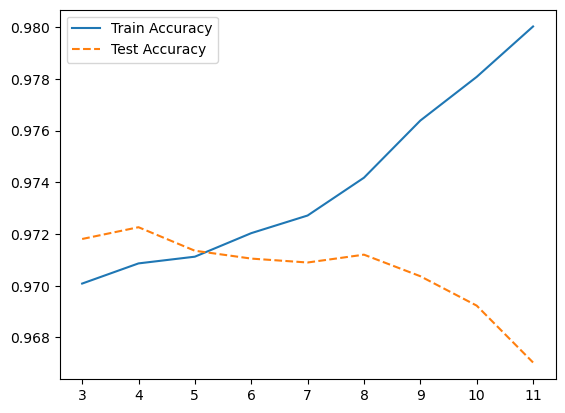

In [27]:
# 모델 정확도 그래프 확인
plt.plot(para_depth, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_depth, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.legend()

#### 깊이(max_depth)에 따른 결과 확인
깊이 = 5

In [51]:
# 변수명 저장
v_feature_name = df_train_x.columns

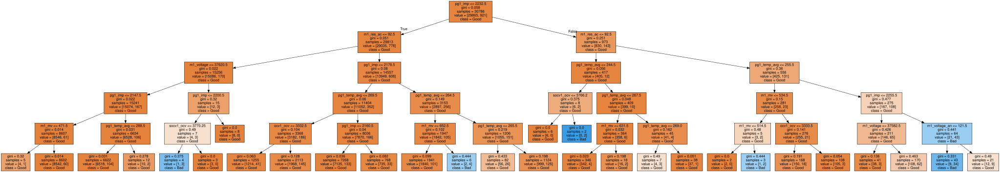

In [52]:
# max_depth, 깊이: 얕은 모델
tree_low = DecisionTreeClassifier(max_depth = 5, random_state=1234)
tree_low.fit(df_train_x, df_train_y)

# 트리 모델을 tree_low.dot 파일로 저장. (목표변수 레이블 지정(class_names):0-Good,1-Bad)
export_graphviz(tree_low, out_file="tree_low.dot", class_names = ["Good", "Bad"], 
                feature_names = v_feature_name, impurity = True, filled = True)

# 트리 결과 시각화
with open("tree_low.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [53]:
# 생성된 .dot 파일을 .png로 변환
call(['dot', '-Tpng', 'tree_low.dot', '-o', 'tree_low.png', '-Gdpi=600'])
# jupyter notebook에서 작업디렉토리에 있는 .png 직접 출력
Image(filename = 'tree_low.png')

### @min_samples_split(분리노드의 최소 샘플 수) 조정에 따른 정확도 변화

#### 참조:적정 크기를 어떻게 결정할  것인가?
* Data의 자료 수 참조...1~5% ?(절대적인 기준은 없음!!)
* 단, leaf 크기의 2배 수준 고려

* min_samples_split 증가 -> 모델 정확도 감소 

In [54]:
# 참조:적정 자료 수 검토:Train Data 자료 수
print("전체 자료 = ", df_train_x.shape[0],"개")
print("전체 자료의 1% = ", df_train_x.shape[0] * 0.01,"개")

전체 자료 =  30786 개
전체 자료의 1% =  307.86 개


In [55]:
# train 및 test 정확도 결과 저장용
train_accuracy = []; test_accuracy = []
# min_samples_split: 분할하기 위한 노드의 최소 샘플 수 
para_split = [n_split * 10 for n_split in range(2, 16)]

for v_min_samples_split in para_split:
    tree = DecisionTreeClassifier(min_samples_split = v_min_samples_split, max_depth=5, random_state=1234)
    tree.fit(df_train_x, df_train_y)
    train_accuracy.append(tree.score(df_train_x, df_train_y))
    test_accuracy.append(tree.score(df_test_x, df_test_y))

# 데이터 테이블로 저장
df_accuracy_split = pd.DataFrame()
df_accuracy_split["MinSamplesSplit"] = para_split
df_accuracy_split["TrainAccuracy"] = train_accuracy
df_accuracy_split["TestAccuracy"] = test_accuracy

In [56]:
para_split

[20, 30, 40, 50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150]

In [57]:
# 모델 정확도 확인
df_accuracy_split.round(3)

,MinSamplesSplit,TrainAccuracy,TestAccuracy
0,20,0.971,0.972
1,30,0.971,0.972
2,40,0.971,0.972
3,50,0.971,0.972
4,60,0.971,0.972
5,70,0.971,0.972
6,80,0.971,0.972
7,90,0.971,0.972
8,100,0.971,0.972
9,110,0.971,0.972


findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font famil

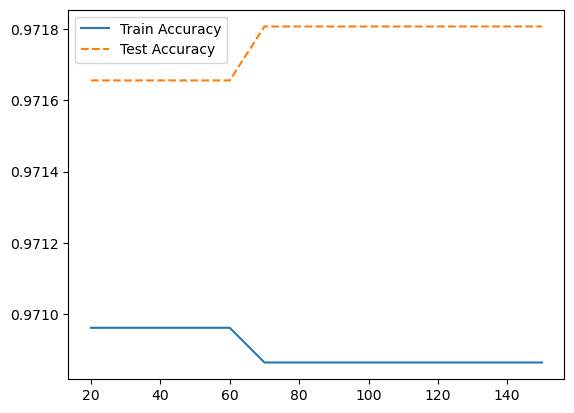

In [58]:
# 정확도를 그래프로 표현
plt.plot(para_split, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_split, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.legend()

split = 70

##### 분리 노드의 최소 샘플 수(min_samples_split)에 따른 차이 

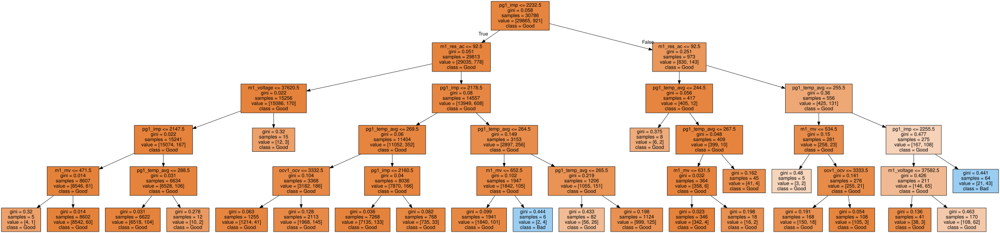

In [59]:
# 분리 노드의 최소 자료 수:적은 모델
tree_low = DecisionTreeClassifier(max_depth=5, min_samples_split=70, random_state=1234)
tree_low.fit(df_train_x, df_train_y)

export_graphviz(tree_low, out_file="tree_low.dot", class_names = ["Good", "Bad"],
                feature_names = v_feature_name, impurity = True, filled = True)

with open("tree_low.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [60]:
# 생성된 .dot 파일을 .png로 변환
call(['dot', '-Tpng', 'tree_low.dot', '-o', 'tree_low.png', '-Gdpi=600'])
# jupyter notebook에서 작업디렉토리에 있는 .png 직접 출력
Image(filename = 'tree_low.png')

# min_samples_split(분리노드의 최소 샘플 수) 지정 : 70

### @min_samples_leaf(잎사귀 노드의 샘플 수) 조정에 따른 정확도 변화

#### 참조:적정 크기를 어떻게 결정할 것인가?
* Data의 자료 수 참조...0.5~5% ?(절대적인 기준은 없음!!)
 
* min_samples_leaf 증가 -> 모델 정확도 감소

In [61]:
# train 및 test 정확도 결과 저장용
train_accuracy = []; test_accuracy = []
# min_samples_leaf: 잎사귀 노드 최소 자료 수. 
para_leaf = [n_leaf * 2 for n_leaf in range(5,16)]

for v_min_samples_leaf in para_leaf:
    tree = DecisionTreeClassifier(min_samples_leaf = v_min_samples_leaf, min_samples_split=70, \
		max_depth=5, random_state=1234)
    tree.fit(df_train_x, df_train_y)
    train_accuracy.append(tree.score(df_train_x, df_train_y))
    test_accuracy.append(tree.score(df_test_x, df_test_y))

# 데이터 테이블로 저장
df_accuracy_leaf = pd.DataFrame()
df_accuracy_leaf["MinSamplesLeaf"] = para_leaf
df_accuracy_leaf["TrainAccuracy"] = train_accuracy
df_accuracy_leaf["TestAccuracy"] = test_accuracy

In [62]:
para_leaf

[10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30]

In [63]:
# 모델 정확도 확인
df_accuracy_leaf.round(3)

,MinSamplesLeaf,TrainAccuracy,TestAccuracy
0,10,0.971,0.972
1,12,0.971,0.972
2,14,0.971,0.972
3,16,0.971,0.972
4,18,0.971,0.972
5,20,0.971,0.972
6,22,0.971,0.972
7,24,0.971,0.972
8,26,0.971,0.972
9,28,0.971,0.972


findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font famil

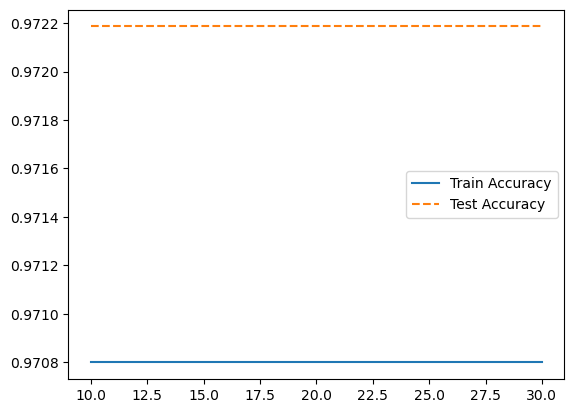

In [64]:
# 모델 정확도 그래프 확인
plt.plot(para_leaf, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_leaf, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.legend()

# min_samples_leaf(잎사귀 노드의 샘플 수) 지정 : x

## 최종 모델 선정 / 시각화

#### 최종 모델:분석가 판단에 따라 변경 가능

In [65]:
tree_final = DecisionTreeClassifier(max_depth=5, min_samples_split=70, min_samples_leaf=v_min_samples_leaf, random_state=1234)
tree_final.fit(df_train_x, df_train_y)

DecisionTreeClassifier(max_depth=5, min_samples_leaf=30, min_samples_split=70,
                       random_state=1234)

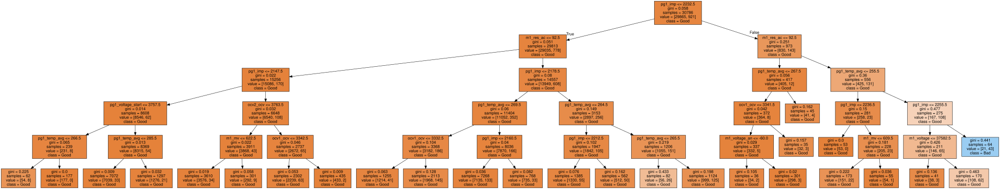

In [66]:
# tree_final.dot으로 결과 저장
export_graphviz(tree_final, out_file="tree_final.dot", class_names = ["Good", "Bad"],
                feature_names = v_feature_name, impurity = True, filled = True)

with open("tree_final.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [67]:
# 생성된 .dot 파일을 .png로 변환
call(['dot', '-Tpng', 'tree_final.dot', '-o', 'tree_final.png', '-Gdpi=600'])
# jupyter notebook에서 작업디렉토리에 있는 .png 직접 출력
Image(filename = 'tree_final.png')

In [68]:
# 평가
y_pred = tree_final.predict(df_test_x)
print("Test Accuracy: {0:.3f}\n".format(tree_final.score(df_test_x, df_test_y)))
print("Test Confusion matrix: \n{}".format(confusion_matrix(df_test_y, y_pred)))

# 목표변수의 빈도 불균형 : f1 score로 모델 평가 
print(classification_report(df_test_y, y_pred, digits=3))

Test Accuracy: 0.972

Test Confusion matrix: 
[[12812    11]
 [  356    16]]
              precision    recall  f1-score   support

           0      0.973     0.999     0.986     12823
           1      0.593     0.043     0.080       372

    accuracy                          0.972     13195
   macro avg      0.783     0.521     0.533     13195
weighted avg      0.962     0.972     0.960     13195



#### 설명변수 중요도
* Importance는 상대적인 값
* Importance = 0 -> 적용 모델의 가지 분리시 해당 변수가 사용되지 않았다는 의미->다른 모델 생성 시에는 변경될 수 있음!!

In [69]:
# tree.feature_importances_로 설명변수 중요도 확인 및 테이블로 저장
df_importance = pd.DataFrame()
df_importance["Feature"] = v_feature_name
df_importance["Importance"] = tree_final.feature_importances_

# df_feature_importance의 테이블을 중요도별로 정렬
df_importance.sort_values("Importance", ascending=False, inplace = True)
df_importance.round(3)

,Feature,Importance
2,pg1_imp,0.380
4,pg1_temp_avg,0.323
9,m1_res_ac,0.228
8,m1_voltage,0.037
0,ocv1_ocv,0.018
10,m1_mv,0.008
1,ocv2_ocv,0.003
3,pg1_voltage_start,0.002
11,m1_voltage_an,0.001
5,socv1_ocv,0.000


Text(0, 0.5, '설명변수')

findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
findfont: Font family 'Malgun Gothic' not found.
/home/piai/anaconda3/lib/python3.10/site-packages/IPython/core/events.py:89: UserWarning: Glyph 49444 (\N{HANGUL SYLLA

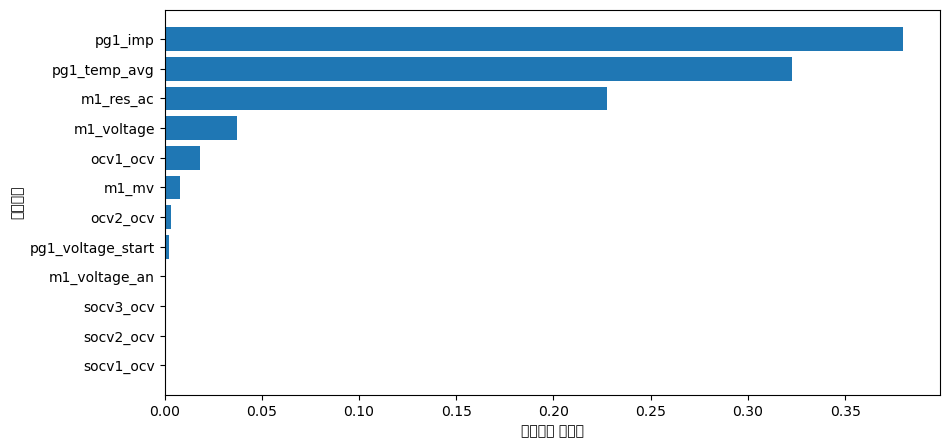

In [70]:
# 설명변수 중요도 그래프
# sort_values : 중요도가 높은 변수를 상위에 그림. 
df_importance.sort_values("Importance", ascending=True, inplace = True)
coordinates = range(len(df_importance))

plt.figure(figsize=(10,5))
plt.barh(y = coordinates, width = df_importance["Importance"])
plt.yticks(coordinates, df_importance["Feature"])
plt.xlabel("설명변수 중요도")
plt.ylabel("설명변수")

#### 참고: 분리기준 변경 및 결과 확인

In [71]:
tree_final2 = DecisionTreeClassifier(criterion='entropy', max_depth=5, min_samples_split=70, min_samples_leaf=v_min_samples_leaf, random_state=1234)
tree_final2.fit(df_train_x, df_train_y)

DecisionTreeClassifier(criterion='entropy', max_depth=5, min_samples_leaf=30,
                       min_samples_split=70, random_state=1234)

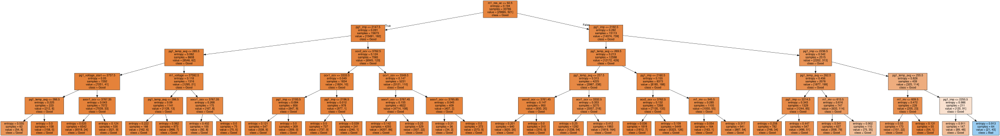

In [72]:
# tree_final.dot으로 결과 저장
export_graphviz(tree_final2, out_file="tree_final2.dot", class_names = ["Good", "Bad"],
                feature_names = v_feature_name, impurity = True, filled = True)

with open("tree_final2.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [73]:
# 생성된 .dot 파일을 .png로 변환
call(['dot', '-Tpng', 'tree_final2.dot', '-o', 'tree_final2.png', '-Gdpi=600'])
# jupyter notebook에서 작업디렉토리에 있는 .png 직접 출력
Image(filename = 'tree_final2.png')

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.798377 to fit


In [74]:
# 평가
y_pred = tree_final.predict(df_test_x)
print("Accuracy: {0:.3f}\n".format(tree_final.score(df_test_x, df_test_y)))
print("Confusion matrix: \n{}".format(confusion_matrix(df_test_y, y_pred)))

# 목표변수의 빈도 불균형 : f1 score로 모델 평가 
print(classification_report(df_test_y, y_pred, digits=3))

Accuracy: 0.972

Confusion matrix: 
[[12812    11]
 [  356    16]]
              precision    recall  f1-score   support

           0      0.973     0.999     0.986     12823
           1      0.593     0.043     0.080       372

    accuracy                          0.972     13195
   macro avg      0.783     0.521     0.533     13195
weighted avg      0.962     0.972     0.960     13195



#### 설명변수 중요도
* Importance는 상대적인 값
* Importance = 0 -> 적용 모델의 가지 분리시 해당 변수가 사용되지 않았다는 의미->다른 모델 생성 시에는 변경될 수 있음!!

In [75]:
# tree.feature_importances_로 설명변수 중요도 확인 및 테이블로 저장
df_importance = pd.DataFrame()
df_importance["Feature"] = v_feature_name
df_importance["Importance"] = tree_final.feature_importances_

# df_feature_importance의 테이블을 중요도별로 정렬
df_importance.sort_values("Importance", ascending=False, inplace = True)
df_importance.round(3)

,Feature,Importance
2,pg1_imp,0.380
4,pg1_temp_avg,0.323
9,m1_res_ac,0.228
8,m1_voltage,0.037
0,ocv1_ocv,0.018
10,m1_mv,0.008
1,ocv2_ocv,0.003
3,pg1_voltage_start,0.002
11,m1_voltage_an,0.001
5,socv1_ocv,0.000
